### 1)

$t$ is our time steps, so $\pm dt = \pm 1$. Plugging in $f(x,t) = \xi^t e^{ikx}$ to the leapfrog scheme we obtain:

\begin{equation} \frac{\xi^{t+1} - \xi^{t-1}}{2dt} e^{ikx} = -v \frac{e^{ikdx} - e^{-ikdx}}{2dx} \xi^t e^{ikx} \end{equation}

Divide by $\xi^{t-1} e^{ikx}$, let $C = v \frac{dt}{dx}$ be the Courant number, and use Euler's formula:

\begin{equation} \xi^2 - 1 = 2 i C \xi \sin(kdx) \end{equation}
\begin{equation} \xi^2 -2ib \xi - 1 = 0 \end{equation}

where $b = C \sin(kdx)$. Solve the quadratic equation:

\begin{equation} \xi = ib \pm \sqrt{1 - b^2} \end{equation}

If the second term of $\xi$ is real, then

\begin{equation} |\xi|^2 = b^2 + 1 - b^2 = 1 \end{equation}

which is exactly what we require, as anything else and $f(x,t)$ would exponentially blow up or decay with time. For second term to be real, we have condition:

\begin{equation} b^2 = C^2 \sin^2(kdx) \leq 1 \end{equation}

$\sin^2(kdx)$ always in $[0,1]$ thus:

\begin{equation} C \leq 1  \end{equation}

which is CFL condition.

### 2)

### a)

In [3]:
import numpy as np
import matplotlib.pyplot as plt

In [359]:
#Define grid going from -n to n, but put first element as [0,0] and wrap around
#so we can have origin in the middle

n=500
x=np.arange(n)
x[n//2:]-=n

#Calculate distance of each point from origin, and find potential which goes as ln(r)
#Note have to remove r=0 at [0,0] just to get a value first

r=np.add.outer(x**2,x**2)
r[0,0]=1
v=np.divide(np.log(r),2*np.pi)

#Each point is average of neighbours. Thus v[1,0]=1/4*(v[1,1]+v[1,-1]+v[2,0]+v[0,0])
#so v[0,0]=4*v[1,0]-v[1,1]-v[1,-1]-v[2,0]

v[0,0]=4*v[1,0]-v[1,1]-v[1,-1]-v[2,0]
v/=v[0,0]

def get_rho(v):
    neighbors=(1/4)*(np.roll(v,1,0)+np.roll(v,-1,0)+np.roll(v,1,1)+np.roll(v,-1,1))
    return(v-neighbors)

rho=get_rho(v)

print('v[0,0]:',v[0,0])
print('v[1,0]:',v[1,0])
print('v[2,0]:',v[2,0])
print('v[5,0]:',v[5,0])
print('rho[0,0]:',rho[0,0])

v[0,0]: 1.0
v[1,0]: -0.0
v[2,0]: -0.5
v[5,0]: -1.160964047443681
rho[0,0]: 1.0


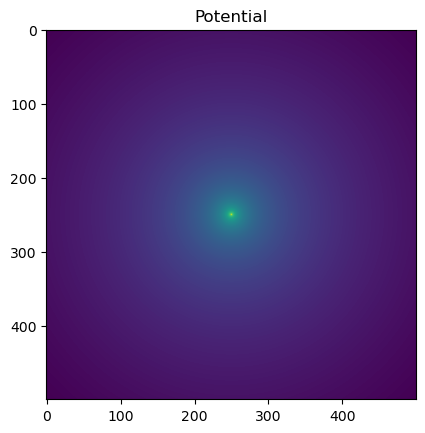

In [360]:
def plot_roll(data,zoom=True):
    rolled=np.roll(data,len(data)//2,(0,1))
    if zoom:
        plt.xlim(0.45*len(data),0.55*len(data))
        plt.ylim(0.45*len(data),0.55*len(data))
    plt.imshow(rolled)

plt.title('Potential')
plot_roll(v,False)

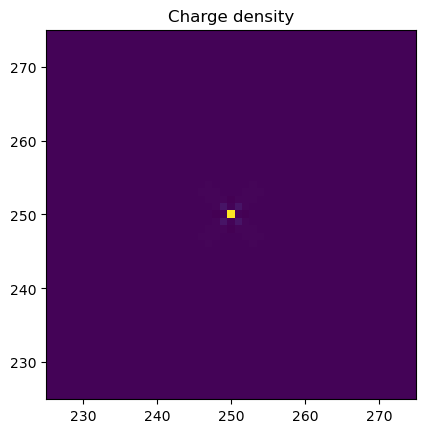

In [361]:
plt.title('Charge density')
plot_roll(rho)

Some extra charge around $[0,0]$. Let's find the potential from these extra charges, subtract that from our current potential, then look at new rho.

### bonus

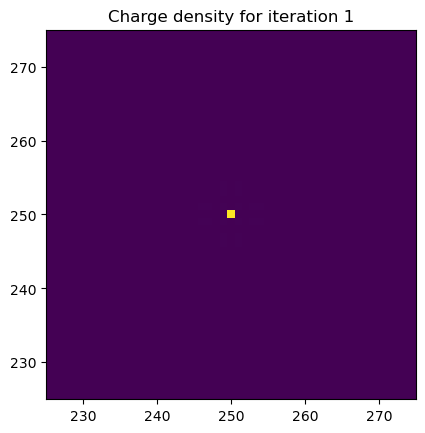

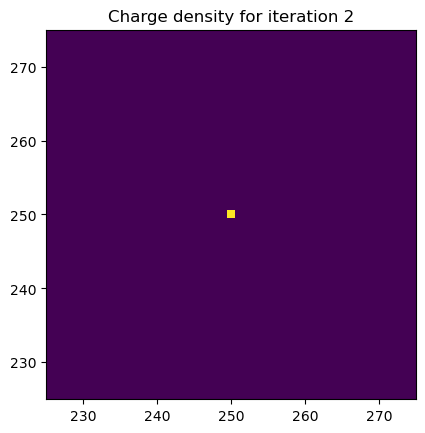

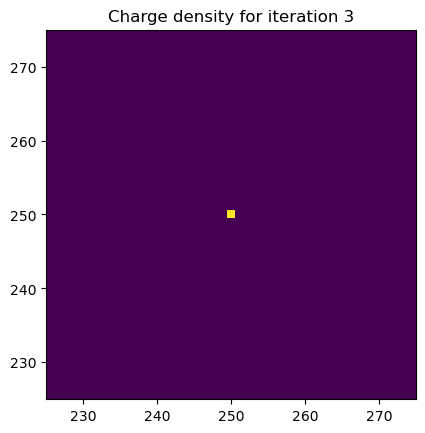

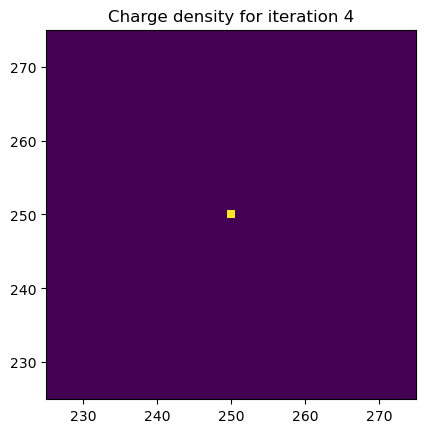

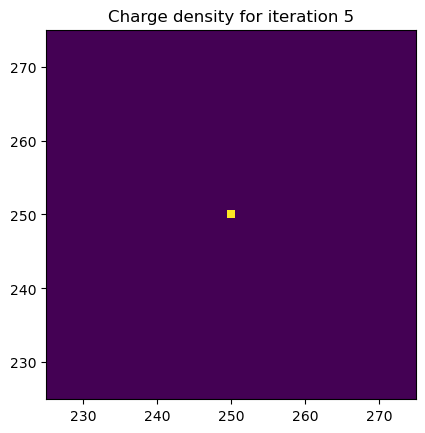

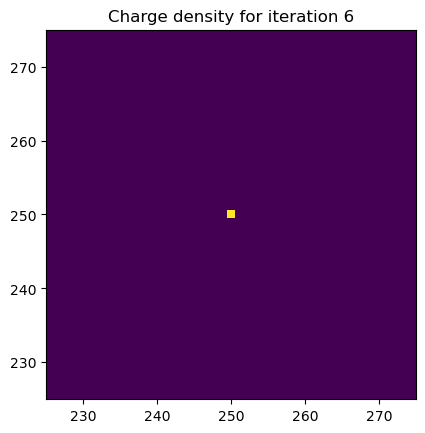

In [362]:
def conv_lin(f,g):
    return np.fft.irfftn(np.fft.rfftn(f)*np.fft.rfftn(g))

iterations=6
for i in range(iterations):
    extra_rho=rho.copy()
    extra_rho[0,0]=0
    v-=conv_lin(extra_rho,v)
    rho=get_rho(v)
    plt.title('Charge density for iteration {}'.format(i+1))
    plot_roll(rho)
    plt.show()

v_point=v.copy()

Immediately charge density looks much better, no other charges apparent near origin anymore. We will use this potential for next part.

### b)

Current residual squared: 2003.749046728629
Current residual squared: 0.4737043227883285
Current residual squared: 0.15261720839722107
Current residual squared: 1765.841858758714
Current residual squared: 0.008586294656213654
Current residual squared: 13900.892078977104
Current residual squared: 0.001944031452440636
Current residual squared: 0.0033455830474053237
Current residual squared: 0.0003343971578424644
Current residual squared: 0.0003080715434859719


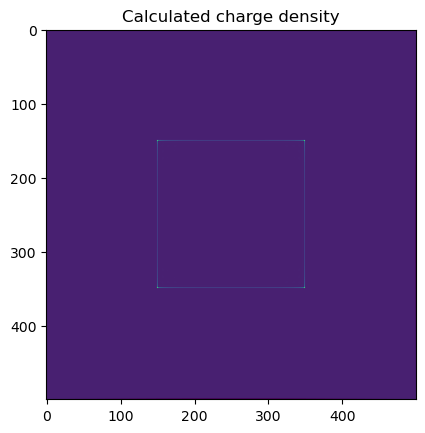

In [363]:
def roll(x,reverse=False):
    if not reverse:
        return np.roll(x,len(x)//2,(0,1))
    else:
        return np.roll(x,-len(x)//2,(0,1))

def get_v(rho_box,v_point,mask):
    rho=np.zeros(np.shape(mask))
    rho[mask]=rho_box
    return np.fft.irfftn(np.fft.rfftn(rho)*np.fft.rfftn(v_point)) 
    
def conjgrad(v_box,v_point,rho_initial,mask,niter=100):
    v_current=get_v(rho_initial,v_point,mask)[mask]
    r=v_box-v_current
    p=r.copy()
    rho=rho_initial.copy()
    rtr=np.sum(r**2)
    for i in range(niter):
        Ap=get_v(p,v_point,mask)[mask]
        pAp=np.sum(p*Ap)
        alpha=rtr/pAp
        rho+=alpha*p
        r-=alpha*Ap
        rtr_new=np.sum(r**2)
        beta=rtr_new/rtr
        p=r+beta*p
        if i%10==0:
            print('Current residual squared:',rtr_new)
        rtr=rtr_new
    return rho
    
mask=np.zeros([n,n],dtype='bool')
bc=np.zeros([n,n])

mask[:,0]=True
mask[0,:]=True
mask[-1,:]=True
mask[:,-1]=True

mask[3*(n//10):7*(n//10),3*(n//10):7*(n//10)]=True
bc[3*(n//10):7*(n//10),3*(n//10):7*(n//10)]=1.0

mask=roll(mask,True)
bc=roll(bc,True)

v_box=bc[mask]
rho_initial=0*v_box
rho_box=conjgrad(v_box,v_point,rho_initial,mask)
rho=np.zeros(np.shape(mask))
rho[mask]=rho_box
plt.title('Calculated charge density')
plot_roll(rho,False)

Our calculated charge density for a box held at potential 1 looks like charges along sides of box with none inside. Looks like charges concentrated in corners.

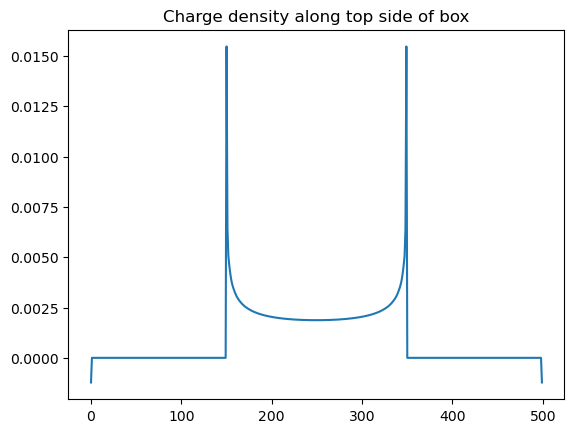

In [398]:
side_rho=roll(rho)[3*(n//10)]
plt.title('Charge density along top side of box')
plt.plot(side_rho)

### c)

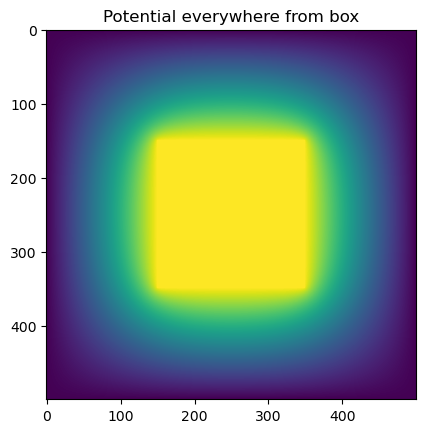

In [397]:
v_everywhere=get_v(rho_box,v_point,mask)
plt.title('Potential everywhere from box')
plot_roll(v_everywhere,False)

Looks as we expected which is good. Potential appears constant inside box

In [399]:
v_inside=v_everywhere[bc==1.0]
print("Mean: {}, Std: {}".format(np.mean(v_inside,),np.std(v_inside)))

Mean: 0.9998485234685628, Std: 7.151381661035092e-05


Potential inside is very close to 1 and nearly constant. To find field, use electric field is negative gradient of potential.

In [415]:
v_quadrant=roll(v_everywhere)[2*(n//10):5*(n//10),2*(n//10):5*(n//10)]
E_x,E_y=np.multiply(-1,np.gradient(v_quadrant))
x,y=np.meshgrid(np.arange(len(v_quadrant)),np.arange(len(v_quadrant)))

fig=plt.figure(figsize=(150,150))
plt.quiver(x,y,E_x,E_y)

Agrees with what we expect. Field is parallel to box sides, which are equipotential, and are stronger at corners.